<a href="https://colab.research.google.com/github/PaleShineSuccess/illusionProject.py/blob/main/plate.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
靈感來源
https://michaelbach.de/ot/col-assim/index.html
https://michaelbach.de/ot/col-context/index.html
https://michaelbach.de/ot/col-fromContour/index.html
https://michaelbach.de/ot/col-McCollough/index.html
https://x.com/AkiyoshiKitaoka/status/1736639923560878399

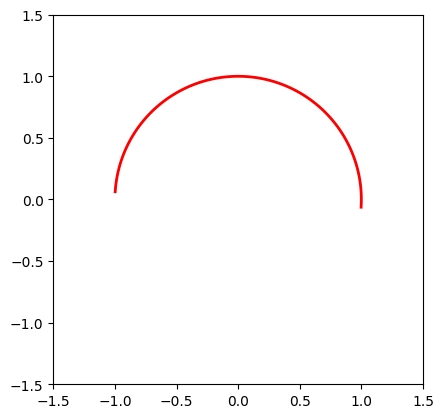

In [ ]:
# prompt: 一段圓弧在旋轉的動畫

import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np

# 設定圓弧參數
center_x = 0
center_y = 0
radius = 1
start_angle = 0  # 起始角度 (弧度)
end_angle = np.pi  # 結束角度 (弧度)
num_points = 100

# 建立圓弧點
theta = np.linspace(start_angle, end_angle, num_points)
x = center_x + radius * np.cos(theta)
y = center_y + radius * np.sin(theta)

# 建立動畫圖表
fig, ax = plt.subplots()
line, = ax.plot([], [], 'r-', lw=2)  # 繪製圓弧的線條

# 設定圖表範圍
ax.set_xlim(-1.5, 1.5)
ax.set_ylim(-1.5, 1.5)
ax.set_aspect('equal')  # 保持比例

# 定義動畫更新函數
def update(frame):
    angle = frame * (2 * np.pi / 100)  # 旋轉角度
    rotated_x = x * np.cos(angle) - y * np.sin(angle)
    rotated_y = x * np.sin(angle) + y * np.cos(angle)
    line.set_data(rotated_x, rotated_y)
    return line,

# 建立動畫物件
ani = animation.FuncAnimation(fig, update, frames=100, interval=50, blit=True)

# 顯示動畫
from IPython.display import HTML
HTML(ani.to_jshtml())

AttributeError: Circle.set() got an unexpected keyword argument 'theta1'

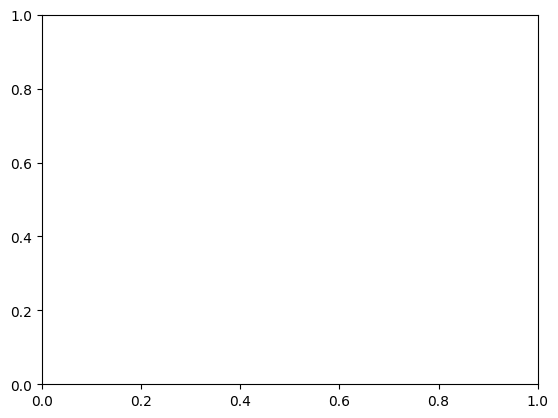

In [ ]:
# prompt: 背景為分別紅藍黃佔據三分一圓的完整圓形，一條黑色的圓弧線段在旋轉，圓弧和圓形的圓心都在同一點，黑色圓弧的路徑為白色空心圓形的動畫

import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
from IPython.display import HTML

# 設定圓弧參數
center_x = 0
center_y = 0
radius = 1
start_angle = 0  # 起始角度 (弧度)
end_angle = np.pi  # 結束角度 (弧度)
num_points = 100

# 建立圓弧點
theta = np.linspace(start_angle, end_angle, num_points)
x = center_x + radius * np.cos(theta)
y = center_y + radius * np.sin(theta)

# 建立動畫圖表
fig, ax = plt.subplots()

# 繪製背景圓形 (紅藍黃三等分)
colors = ['red', 'blue', 'yellow']
for i in range(3):
    wedge = plt.Circle((0, 0), radius, fill=True, color=colors[i],
                       angle=(i * 120), theta1=0, theta2=120)
    ax.add_artist(wedge)

# 繪製圓弧的線條
line, = ax.plot([], [], 'k-', lw=2)

# 繪製白色空心圓
circle = plt.Circle((0,0), radius * 1.1, color='white', fill=False, linewidth=1)
ax.add_artist(circle)

# 設定圖表範圍
ax.set_xlim(-1.5, 1.5)
ax.set_ylim(-1.5, 1.5)
ax.set_aspect('equal')  # 保持比例
ax.set_axis_off() #隱藏坐標軸


# 定義動畫更新函數
def update(frame):
    angle = frame * (2 * np.pi / 100)  # 旋轉角度
    rotated_x = x * np.cos(angle) - y * np.sin(angle)
    rotated_y = x * np.sin(angle) + y * np.cos(angle)
    line.set_data(rotated_x, rotated_y)
    return line,


# 建立動畫物件
ani = animation.FuncAnimation(fig, update, frames=100, interval=50, blit=True)

# 顯示動畫
HTML(ani.to_jshtml())

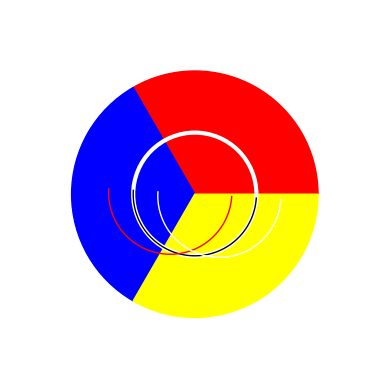

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
from IPython.display import HTML
#from matplotlib.patches import Wedge # Import Wedge for creating sectors
from matplotlib.patches import Wedge, Circle
# 設定圓弧參數
center_x = 0
center_y = 0
radius = 0.5
start_angle = 0  # 起始角度 (弧度)
end_angle = np.pi  # 結束角度 (弧度)
num_points = 100
arc_width = 1 #設定圓弧寬度

# 建立圓弧點
theta = np.linspace(start_angle, end_angle, num_points)
x = center_x + radius * np.cos(theta)
y = center_y + radius * np.sin(theta)

# 紅色和藍色圓弧使用相同的中心點和半徑，只更改顏色和繪製位置
x_red = x + 0.2  # 紅色圓弧與黑色圓弧使用相同的 x 坐標
y_red = y  # 紅色圓弧與黑色圓弧使用相同的 y 坐標

x_blue = x  - 0.2# 藍色圓弧與黑色圓弧使用相同的 x 坐標
y_blue = y  # 藍色圓弧與黑色圓弧使用相同的 y 坐標

# 建立背景圓形
# Use Wedge for creating sectors
circle = plt.Circle((center_x, center_y), radius*2, fill=False, edgecolor='none') # 透明背景
red_sector = Wedge((center_x, center_y), radius*2, 0, 120, color='red') # Changed to Wedge
blue_sector = Wedge((center_x, center_y), radius*2, 120, 240, color='blue') # Changed to Wedge
yellow_sector = Wedge((center_x, center_y), radius*2, 240, 360, color='yellow') # Changed to Wedge


# 建立動畫圖表
fig, ax = plt.subplots()
ax.add_patch(circle) # 加入背景圓
ax.add_patch(red_sector)
ax.add_patch(blue_sector)
ax.add_patch(yellow_sector)

line, = ax.plot([], [], 'k-', lw=arc_width)  # 繪製黑色圓弧，調整線寬
line_red, = ax.plot([], [], 'r-', lw=arc_width)  # 紅色圓弧
line_blue, = ax.plot([], [], 'b-', lw=arc_width)  # 藍色圓弧

#建立空心圓，並設定寬度
hollow_circle = Circle((center_x, center_y), radius * 1, # 半徑為圓弧半徑的 x 倍
                       fill=False, edgecolor='white', linewidth=3) # 填充為 False，白色邊緣，線寬為 x

ax.add_patch(hollow_circle)  # 將空心圓添加到繪圖區域




# 設定圖表範圍
ax.set_xlim(-1.5, 1.5)
ax.set_ylim(-1.5, 1.5)
ax.set_aspect('equal')  # 保持比例
ax.axis('off')  # 關閉坐標軸

# 定義動畫更新函數
def update(frame):
    angle = frame * (2 * np.pi / 100)  # 旋轉角度
    rotated_x = x * np.cos(angle) - y * np.sin(angle)
    rotated_y = x * np.sin(angle) + y * np.cos(angle)
    line.set_data(rotated_x, rotated_y)

        # 旋轉紅色圓弧，並根據位置更改顏色
    rotated_x_red = x_red * np.cos(angle) - y_red * np.sin(angle)
    rotated_y_red = x_red * np.sin(angle) + y_red * np.cos(angle)
    line_red.set_data(rotated_x_red, rotated_y_red)
    if (angle * 180 / np.pi) % 360 < 120:
        line_red.set_color('white')  # 在紅色區域時變成白色
    else:
        line_red.set_color('red')  # 其他區域恢復紅色

    # 旋轉藍色圓弧，並根據位置更改顏色
    rotated_x_blue = x_blue * np.cos(angle) - y_blue * np.sin(angle)
    rotated_y_blue = x_blue * np.sin(angle) + y_blue * np.cos(angle)
    line_blue.set_data(rotated_x_blue, rotated_y_blue)

    # 判斷藍色圓弧是否在藍色區域 (角度在 120 到 240 度之間)
    if (angle * 180 / np.pi) % 360 >= 120 and (angle * 180 / np.pi) % 360 < 240:
        line_blue.set_color('white')  # 在藍色區域時變成白色
    else:
        line_blue.set_color('blue')  # 其他區域恢復藍色

    return line, line_red# 記得返回所有線條物件



# 建立動畫物件
ani = animation.FuncAnimation(fig, update, frames=50, interval=50, blit=True)

# 顯示動畫
HTML(ani.to_jshtml())

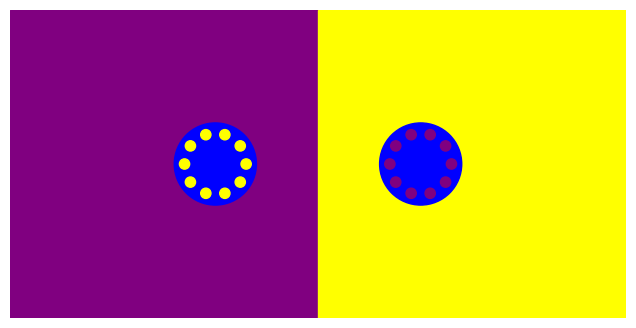

In [ ]:
# prompt: 兩個藍球分居左右，左邊紫色背景填滿，上面滿佈規律分佈的黃色斑點，右邊黃色背景填滿，上面滿佈規律分佈的紫色斑點的一張畫

import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
from IPython.display import HTML
from matplotlib.patches import Circle

# Set up the figure and axes
fig, ax = plt.subplots(figsize=(8, 4))  # Adjust figure size for better layout
ax.set_aspect('equal')
ax.axis('off')  # Hide axes

# Define colors and positions
left_background_color = 'purple'
right_background_color = 'yellow'
spot_color_left = 'yellow'
spot_color_right = 'purple'

# Create the basketballs
basketball_radius = 0.4

# Left basketball
left_basketball = Circle((-1, 0), basketball_radius, color='blue')
ax.add_patch(left_basketball)
# Add yellow spots to left basketball (replace with your preferred pattern)
for i in range(10): # Number of spots
    angle = i * 2 * np.pi / 10
    x = -1 + 0.3 * np.cos(angle)
    y = 0 + 0.3 * np.sin(angle)
    spot = Circle((x, y), 0.05, color=spot_color_left)
    ax.add_patch(spot)


# Right basketball
right_basketball = Circle((1, 0), basketball_radius, color='blue')
ax.add_patch(right_basketball)
# Add purple spots to right basketball
for i in range(10):
    angle = i * 2 * np.pi / 10
    x = 1 + 0.3 * np.cos(angle)
    y = 0 + 0.3 * np.sin(angle)
    spot = Circle((x, y), 0.05, color=spot_color_right)
    ax.add_patch(spot)

# Create background rectangles (using patches)
left_rect = plt.Rectangle((-3,-1.5), 4, 3, color=left_background_color, zorder=0)  # zorder ensures the background is behind
ax.add_patch(left_rect)

right_rect = plt.Rectangle( (0,-1.5), 4, 3, color=right_background_color, zorder=0)
ax.add_patch(right_rect)


# Set limits
ax.set_xlim(-3, 3)
ax.set_ylim(-1.5, 1.5)


plt.show()

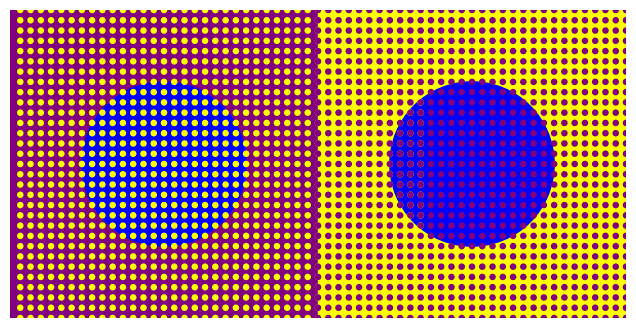

In [ ]:
# prompt: 左邊畫面裡正方形地規律地排列的黃色圓圈，畫面的中心黃色圓圈們的圖層下放置一個藍色的球，最下面是紫色方形，黃色圓圈在最上面，右邊也一樣，但最下面是黃色方形，最上面紫色圓圈，圓圈們全部都要是正方形排列！覆蓋滿最下面的方形！

import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Circle, Rectangle

# Set up the figure and axes
fig, ax = plt.subplots(figsize=(8, 4))  # Adjust figure size for better layout
ax.set_aspect('equal')
ax.axis('off')  # Hide axes

# Define colors and positions
left_background_color = 'purple'
right_background_color = 'yellow'
spot_color_left = 'yellow'
spot_color_right = 'purple'
circle_color = 'yellow'
circle_color_right = 'purple'


# Parameters for the circle arrangement
num_rows = 40
num_cols = num_rows
circle_radius = 0.025
grid_spacing = 0.1


def create_circles(start_x, start_y, num_rows, num_cols, color):
  circles = []
  for i in range(num_rows):
      for j in range(num_cols):
          x = start_x + j * grid_spacing
          y = start_y + i * grid_spacing
          circle = Circle((x, y), circle_radius, color=color)
          circles.append(circle)
          ax.add_patch(circle)
  return circles

# Create the basketballs
basketball_radius = 0.8

# Left basketball
left_basketball = Circle((-1.5, 0), basketball_radius, color='blue')
ax.add_patch(left_basketball)

# Right basketball
right_basketball = Circle((1.5, 0), basketball_radius, color='blue')
ax.add_patch(right_basketball)

# Create background rectangles
left_rect = Rectangle((-3,-1.5), 4, 3, color=left_background_color, zorder=0)
ax.add_patch(left_rect)

right_rect = Rectangle( (0,-1.5), 4, 3, color=right_background_color, zorder=0)
ax.add_patch(right_rect)


# Add yellow circles on the left
create_circles(-2.9, -1.5, num_rows, num_cols, circle_color)

# Add purple circles on the right
create_circles(0, -1.5, num_rows, num_cols, circle_color_right)


# Set limits
ax.set_xlim(-3, 3)
ax.set_ylim(-1.5, 1.5)


plt.show()

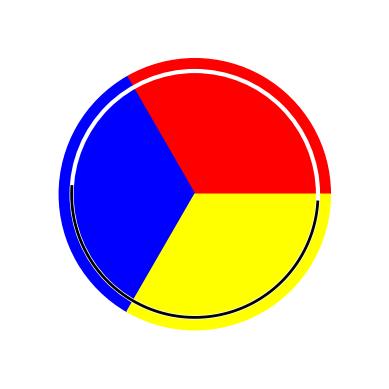

In [ ]:
# prompt: 一個像雷達一樣旋轉掃描的黑白圓形動畫

import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
from IPython.display import HTML
from matplotlib.patches import Wedge, Circle

# 設定圓弧參數
center_x = 0
center_y = 0
radius = 1
start_angle = 0  # 起始角度 (弧度)
end_angle = np.pi  # 結束角度 (弧度)
num_points = 100
arc_width = 2  # 設定圓弧寬度

# 建立圓弧點
theta = np.linspace(start_angle, end_angle, num_points)
x = center_x + radius * np.cos(theta)
y = center_y + radius * np.sin(theta)

# 建立背景圓形 (紅藍黃三等分)
fig, ax = plt.subplots()
colors = ['red', 'blue', 'yellow']
for i in range(3):
    wedge = Wedge((0, 0), radius * 1.1, i * 120, (i + 1) * 120, color=colors[i])
    ax.add_artist(wedge)

# 繪製圓弧的線條
line, = ax.plot([], [], 'k-', lw=arc_width)

# 繪製白色空心圓
circle = Circle((0, 0), radius * 1, color='white', fill=False, linewidth=3)
ax.add_artist(circle)

# 設定圖表範圍
ax.set_xlim(-1.5, 1.5)
ax.set_ylim(-1.5, 1.5)
ax.set_aspect('equal')  # 保持比例
ax.set_axis_off()  # 隱藏坐標軸

# 定義動畫更新函數
def update(frame):
    angle = frame * (2 * np.pi / 100)  # 旋轉角度
    rotated_x = x * np.cos(angle) - y * np.sin(angle)
    rotated_y = x * np.sin(angle) + y * np.cos(angle)
    line.set_data(rotated_x, rotated_y)
    return line,

# 建立動畫物件
ani = animation.FuncAnimation(fig, update, frames=50, interval=50, blit=True)

# 顯示動畫
HTML(ani.to_jshtml())

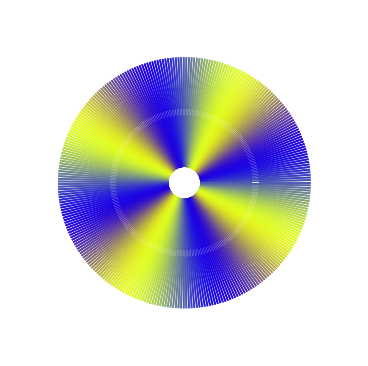

In [ ]:
#用三分鐘來生成太久了

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation


# 初始化參數
width, height = 450, 450
shortside = min(width, height)
xOffset = 0
num = 300  # 線條數
radius = shortside * 0.12  # 圓半徑
times = 4  # 顏色交替的次數


# 預先計算線條初始位置
lines_data = []
for i in range(num):
    angle = np.linspace(0, 2 * np.pi, num)[i]
    x4 = radius * np.cos(angle) * 3
    y4 = radius * np.sin(angle) * 3
    x3 = radius * np.cos(angle) * 1.8
    y3 = radius * np.sin(angle) * 1.8
    x2 = radius * np.cos(angle) * 1.6
    y2 = radius * np.sin(angle) * 1.6
    x = radius * np.cos(angle) * 0.4
    y = radius * np.sin(angle) * 0.4
    lines_data.append([ [x3, x4], [y3, y4], [x, x2], [y, y2], [x2, x3], [y2, y3]])



# 輔助函數

def lerpColor(color1, color2, t):
    return [(1 - t) * c1 + t * c2 for c1, c2 in zip(color1, color2)]

# 創建畫布
fig, ax = plt.subplots(figsize=(width / 100, height / 100))
ax.set_xlim(-width // 2, width // 2)
ax.set_ylim(-height // 2, height // 2)
ax.axis('off')

lines = []
for _ in range(num):
    line, = ax.plot([], [], lw=1)
    lines.append(line)

def update(frame):
    global xOffset
    ax.clear()
    ax.set_xlim(-width // 2, width // 2)
    ax.set_ylim(-height // 2, height // 2)
    ax.axis('off')
    updated_artists = [] # 创建一个列表来存储更新的artist对象

    for i, line in enumerate(lines):
        angle = np.linspace(0, 2 * np.pi, num)[i]
        midab = (np.sin(angle * times + xOffset) * 0.5 + 0.5)
        midcd = (np.sin(angle * times - xOffset) * 0.5 + 0.5)
        mixabcd = (np.sin(frame / 25) * 0.5 + 0.5)

        abcolor = lerpColor([1, 1, 0], [0, 0, 1], midab)  # 黃藍漸層
        cdcolor = lerpColor([0, 1, 1], [1, 0, 0], midcd)  # 紅藍漸層
        mixcolor = lerpColor(abcolor, cdcolor, mixabcd)

        x4 = radius * np.cos(angle) * 3
        y4 = radius * np.sin(angle) * 3
        x3 = radius * np.cos(angle) * 1.8
        y3 = radius * np.sin(angle) * 1.8
        x2 = radius * np.cos(angle) * 1.6
        y2 = radius * np.sin(angle) * 1.6
        x = radius * np.cos(angle) * 0.4
        y = radius * np.sin(angle) * 0.4

        ax.plot([x3, x4], [y3, y4], color=mixcolor, lw=1.2)
        ax.plot([x, x2], [y, y2], color=mixcolor, lw=1.2)
        ax.plot([x2, x3], [y2, y3], color=mixcolor, lw=0.8)
        line1, = ax.plot([x3, x4], [y3, y4], color=mixcolor, lw=1.2) # 分配给一个变量
        line2, = ax.plot([x, x2], [y, y2], color=mixcolor, lw=1.2) # 分配给一个变量
        line3, = ax.plot([x2, x3], [y2, y3], color=mixcolor, lw=0.8) # 分配给一个变量
        updated_artists.extend([line1, line2, line3]) # 将线条添加到 updated_artists 列表中

    xOffset += 0.06 * np.pi
    return updated_artists # 返回更新的artist对象列表

ani = FuncAnimation(fig, update, frames=range(100), interval=50, blit=True)
from IPython.display import HTML
HTML(ani.to_jshtml())


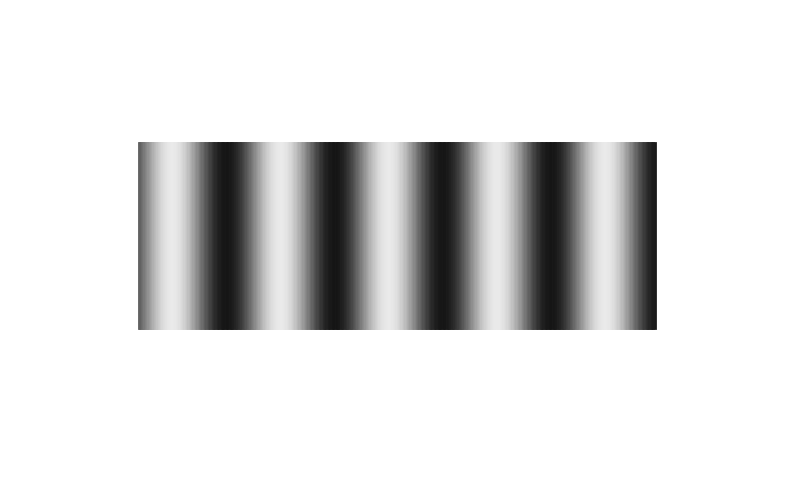

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# 設置畫布大小
fig, ax = plt.subplots(figsize=(10, 6))
ax.set_xlim(0, 600)
ax.set_ylim(0, 400)
ax.axis("off")  # 隱藏軸線

# 初始化參數
xOffset = 0.5
lineHeightOffset = 75  # 線條的高度偏移量
lineHeight = 85        # 上下線條的間隔
x_values = np.arange(100, 500)  # x 軸範圍

# 顏色插值函數
def lerp_color(color1, color2, t):
    return [(1 - t) * c1 + t * c2 for c1, c2 in zip(color1, color2)]

# 初始化動畫繪圖對象
lines = []
for _ in x_values:
    line, = ax.plot([], [], lw=2)
    lines.append(line)

def animate(frame):
    global xOffset
    xOffset += 0.25

    for i, x in enumerate(x_values):
        midab = np.sin(x * 0.075 + xOffset) * 0.5 + 0.5
        midcd = np.sin(x * 0.075 - xOffset) * 0.5 + 0.5

        # 黃藍漸層
        abcolor = lerp_color([1, 1, 1], [0, 0, 0], midab)
        # 紅藍漸層
        cdcolor = lerp_color([0, 0, 0], [1, 1, 1], midcd)
        # 雙色漸層
        combine = lerp_color(abcolor, cdcolor, 0.5)

        # 繪製線條
        y_start = 200 - lineHeightOffset
        y_end = 200 + lineHeight
        lines[i].set_data([x, x], [y_start, y_end])
        lines[i].set_color(combine)

    return lines

# 創建動畫
anim = FuncAnimation(fig, animate, frames=200, interval=50, blit=True)

# 顯示動畫
from IPython.display import HTML
HTML(anim.to_jshtml())


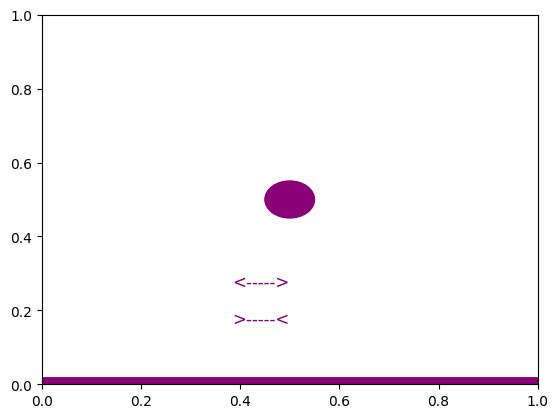

In [ ]:
# prompt: 一條以紫藍青綠黃橙紅的順序不斷漸變顏色，過程平滑的線條動畫

import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
from IPython.display import HTML
from matplotlib import colors

# Define colors for the gradient
#colors = ['purple', 'blue', 'cyan', 'green', 'yellow', 'orange', 'red']
colors_list = ['purple', 'blue', 'cyan', 'green', 'yellow', 'orange', 'red'] # Changed variable name to avoid conflict

# Create the figure and axes
fig, ax = plt.subplots()
ax.set_xlim(0, 1)
ax.set_ylim(0, 1)  # Adjt the y-axis limits for the line thickness
#ax.axis('off')  # Hide the axes

# Create the line object
line, = ax.plot([], [], lw=10) # Set a larger line width
#o1 = ax.add_patch（circle）
circle = plt.Circle((0.5, 0.5), 0.05, color='lightgray', fill=True)  # Circle parameters
o1 = ax.add_patch(circle)  # Add the circle to the axes
h1 = ax.text(0.5, 0.2, '>-----<', ha="right", va="top", fontsize=12, color='black')  # Add text "A"
h2 = ax.text(0.5, 0.3, '<----->', ha="right", va="top", fontsize=12, color='black')

'''
def update(frame):
    # Calculate the gradient color
    num_colors = len(colors)
    color_index = int((frame / 100) * (num_colors - 1)) # Normalize frame to color range

    # Smooth color transition using interpolation
    if color_index < num_colors - 1:
        t = (frame / 100) * (num_colors - 1) - color_index
        color = plt.cm.get_cmap('viridis')(t) # Use a colormap for smooth interpolation
    else:
      color = colors[-1]
'''
#def update(frame):
    # Calculate the gradient color using a cyclical approach
    #num_colors = len(colors)
    #color_index_float = (frame / 100) * num_colors  # Allow float for smoother transition
   # color_index_int = int(color_index_float)       # Integer part for color selection

def update(frame):
    # Calculate the gradient color using a cyclical approach
    num_colors = len(colors_list)  # Change this line to use colors_list
    color_index_float = (frame / 100) * num_colors  # Allow float for smoother transition
    color_index_int = int(color_index_float)       # Integer part for color selection


    # Smooth color transition using interpolation
    t = color_index_float - color_index_int       # Fractional part for interpolation

    ## Cyclical color selection
    #color1 = colors[color_index_int % num_colors]
    #color2 = colors[(color_index_int + 1) % num_colors]

    # Cyclical color selection
    color1 = colors_list[color_index_int % num_colors] # Use colors_list
    color2 = colors_list[(color_index_int + 1) % num_colors] # Use colors_list


    # Interpolate between colors
    color = lerp_color(color1, color2, t)  # Assuming you have a lerp_color function

    # Cyclical color selection
    #color1 = colors_list[color_index_int % num_colors] # Use colors_list
    #color2 = colors_list[(color_index_int + 1) % num_colors] # Use colors_list


    # Update the line data and color
    line.set_data([0, 1], [0, 0])
    line.set_color(color)
    o1.set_color(color)
    h1.set_color(color)
    h2.set_color(color)
    return line,o1,h1,h2


# Define a lerp_color function (if you don't have one already)
def lerp_color(color1, color2, t):
    # Convert color names to RGB tuples using matplotlib's color converter
   # rgb1 = plt.colors.to_rgb(color1)
  #  rgb2 = plt.colors.to_rgb(color2)

    # Convert color names to RGB tuples using matplotlib's color converter
    rgb1 = colors.to_rgb(color1) # Access to_rgb from colors module
    rgb2 = colors.to_rgb(color2) # Access to_rgb from colors module


    # Interpolate between RGB values
    rgb = [(1 - t) * c1 + t * c2 for c1, c2 in zip(rgb1, rgb2)]

    # Return the interpolated color as an RGB tuple
    return rgb

# Create the animation
ani = animation.FuncAnimation(fig, update, frames=100, interval=20, blit=True)

# Display the animation
HTML(ani.to_jshtml())